In [1]:
# Importing required libraries

# Library for data cleaning and data manipulation
import pandas as pd
import numpy as np

# Library for data visualization
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
import geopandas as gpd

# Library for normality test
import scipy.stats as stats

In [3]:
# Load the Dataset
df = pd.read_csv(r"C:\Users\user\OneDrive\Documents\Airbnb-Listings-Bangkok-Project\data\cleaned\data_cleaned.csv")

# Drop unnecessary columns from the dataset
df.drop(columns=["id", "host_id"], inplace=True)

### **4.1. Geospatial Competition and Listing Density**

**Goal:** To investigate how the concentration of Airbnb listings in specific neighborhoods affects the level of competition among hosts and how it influences the pricing of listings in Bangkok.<br>

**Approach:** Use the Kruskal-Wallis test to assess if there are significant differences in average prices across different neighborhoods, which will help identify whether competition (in terms of listing density) impacts pricing strategies.

**Hypothesis Testing:**
- **H0** : There is no significant difference in the median price of Airbnb listings between different neighborhoods (This means that neighborhood does not affect the price of listings)
- **H1** :  There is a significant difference in the median price of Airbnb listings between different neighborhoods (This means that the location (neighborhood) significantly influences the price of Airbnb listings)

In [4]:
from scipy import stats
# Group data by neighbourhood and extract the price data for each neighborhood
test_hip = [df[df['neighbourhood'] == neighbourhood]['price']
                for neighbourhood in df['neighbourhood'].unique()]

# Perform Kruskal-Wallis test
kruskal_result = stats.kruskal(*test_hip)

# Step 3: Display the results of Kruskal-Wallis
print("Kruskal-Wallis H-statistic:", kruskal_result.statistic)
print("Kruskal-Wallis p-value:", kruskal_result.pvalue)

# Step 4: Interpret the results
if kruskal_result.pvalue > 0.05:
    print(f'''
    pvalue={kruskal_result.pvalue}. pvalue > 0.05. Except Ho.
    I don't have enough evidence to conclude that the median price across different neighborhoods in Bangkok is significantly different.
    ''')
else:
    print(f'''
    pvalue={kruskal_result.pvalue}. pvalue <= 0.05. Reject Ho.
    I have enough evidence to conclude that the median price across different neighborhoods in Bangkok is significantly different.
    ''')

Kruskal-Wallis H-statistic: 2015.1185729999513
Kruskal-Wallis p-value: 0.0

    pvalue=0.0. pvalue <= 0.05. Reject Ho.
    I have enough evidence to conclude that the median price across different neighborhoods in Bangkok is significantly different.
    


**Conclusion:**<br>
These results indicate that '**neighbourhoods**' have a significant impact on '**price**' compared to standard seasonal advertising. This means that this '**neighbourhoods**' is effective in increasing '**price**' at the airbnb listings Bangkok.

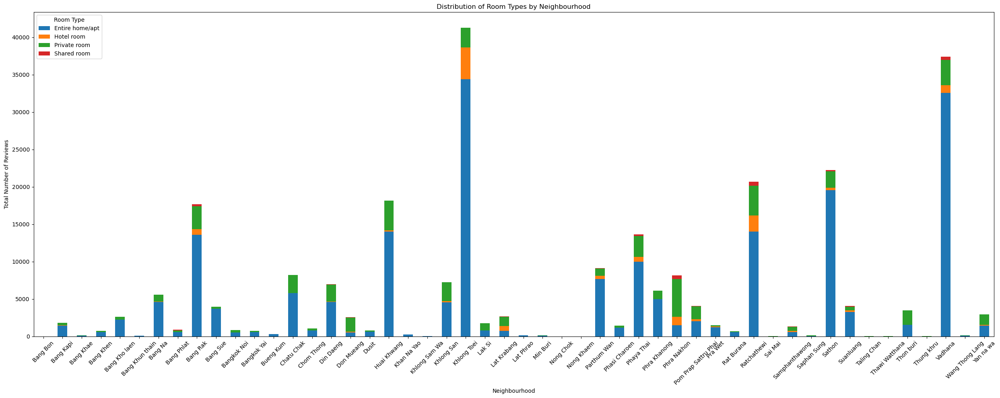

In [ ]:
# Group data by 'neighbourhood' and 'room_type'
grouped_data = df.groupby(["neighbourhood", "room_type"])['number_of_reviews'].sum().unstack(fill_value=0)

# Reset index for plotting
grouped_data = grouped_data.reset_index()

# Create a stacked bar plot
ax = grouped_data.set_index('neighbourhood').plot(kind='bar', stacked=True, figsize=(25, 10))

# Formatting the plot
plt.title('Distribution of Room Types by Neighbourhood')
plt.xlabel('Neighbourhood')
plt.ylabel('Total Number of Reviews')
plt.xticks(rotation=45)
plt.legend(title='Room Type')
plt.tight_layout()  # To ensure the plot doesn't get cut off

# Display the plot
plt.show()

**Insight:**<br>
The "Entire home/apt" category consistently dominates the distribution across most neighborhoods. This suggests a strong preference for independent accommodations among Airbnb users. Neighborhoods with a higher number of listings across all room types are likely to be popular tourist destinations or have a high concentration of Airbnb hosts.

**Visualizing Listing Density and Price Distribution**

In [5]:
# Select relevant columns for the analysis
geo_data = df[["latitude", "longitude", "neighbourhood", "room_type", "price"]]

# Load the data geojson
geojson_path = 'C:/Users/user/OneDrive/Documents/Airbnb-Listings-Bangkok-Project/notebooks/Bangkok-districts.geojson'

# Initialize a base map centered around Bangkok
bangkok_map = folium.Map(
    location=[13.7563, 100.5018],
    zoom_start=12,
    tiles="https://cartodb-basemaps-{s}.global.ssl.fastly.net/light_all/{z}/{x}/{y}{r}.png",
    attr='Map data &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors | Tiles &copy; <a href="https://carto.com/attributions">CARTO</a>',
    max_bounds=True,
    min_zoom=10, 
    max_bounds_viscosity=1.0,
    max_zoom=15,  
    max_bounds_readable=True  
)

# Overlay neighborhood boundaries on the map
folium.GeoJson(
    geojson_path,
    name='Neighbourhoods',
    style_function=lambda feature: {
        'fillColor': '#f8f8f8',
        'color': 'red',
        'weight': 2,
        'dashArray': '5, 5'
    }
).add_to(bangkok_map)

# Add a marker cluster to better manage dense regions
marker_cluster = MarkerCluster().add_to(bangkok_map)

# Define room type icons and colors
room_type_icons = {
    "Entire home/apt": ("red", "home"),
    "Private room": ("green", "user"),
    "Hotel room": ("blue", "hotel"),
    "Shared room": ("gray", "users")
}

# Place markers on the map with appropriate color and icon for each room type
for index, row in geo_data.iterrows():
    color, icon = room_type_icons.get(row["room_type"], ("black", "question-sign"))
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"Neighbourhood: {row['neighbourhood']}\nRoom Type: {row['room_type']}\nPrice: {row['price']} THB",
        icon=folium.Icon(color=color, icon=icon, prefix='fa')
    ).add_to(marker_cluster)

# Mark popular tourist destinations on the map
tourist_spots = {
    "Grand Palace": [13.7515, 100.4927],
    "Wat Arun": [13.7437, 100.4886],
    "Khao San Road": [13.7594, 100.4976],
    "Chatuchak Market": [13.7990, 100.5500],
    "Siam Paragon": [13.7462, 100.5349],
    "Wat Pho": [13.7466, 100.4923],
    "MBK Center": [13.7446, 100.5296],
    "Yaowarat": [13.7402796, 100.5071928],
    "Lumphini Park": [13.7314281, 100.5391235],
    "Siam Amazing Park": [13.8151288, 100.6320818]
}

for spot, coordinates in tourist_spots.items():
    folium.Marker(
        location=coordinates,
        popup=f"Tourist Spot: {spot}",
        icon=folium.Icon(color="red", icon="info-sign")
    ).add_to(bangkok_map)

# Add markers for airports
airports = {
    "Suvarnabhumi Airport (BKK)": [13.6900, 100.7500],
    "Don Mueang Airport (DMK)": [13.9125, 100.6074]
}

for airport, coordinates in airports.items():
    folium.Marker(
        location=coordinates,
        popup=f"Airport: {airport}",
        icon=folium.Icon(color="black", icon="plane")
    ).add_to(bangkok_map)

# Add markers for universities
universities = {
    "Chulalongkorn University": [13.7462, 100.5320],
    "Thammasat University": [13.7564, 100.4931],
    "Mahidol University": [13.8185, 100.3282]
}

for university, coordinates in universities.items():
    folium.Marker(
        location=coordinates,
        popup=f"University: {university}",
        icon=folium.Icon(color="green", icon="university")
    ).add_to(bangkok_map)

# Add layer control to toggle map layers on or off
folium.LayerControl().add_to(bangkok_map)

bangkok_map

**Insight:**<br>
- **Geographical Distribution:**<br> In the central district, there are significant clusters of Airbnb listings, suggesting a high demand for short-term rentals in these tourist-heavy and business-centric areas. These regions are likely favored by both international tourists and business travelers due to their proximity to key attractions and transit options.
- **Room Type Distribution:**<br> **The red markers** for **entire home/apartment listings** are **concentrated in popular areas**, reflecting the demand for larger, more private accommodations by tourists. On the other hand, **private rooms (green markers)** are more **widely distributed** across non-central neighborhoods, indicating a greater supply of budget-friendly options for solo travelers or those seeking shorter stays.
- **Most Popular Neighbourhood:**<br> Vadhana **with over 2000 listings** is the **most popular neighborhood** for Airbnb in Bangkok. This suggests that it's a highly sought-after area for tourists or has a significant number of residents renting out their properties.
- **Proximity to Key Locations:**<br> The proximity of Airbnb listings to **key tourist spots**, **such as Grand Palace and Wat Arun**, influences the pricing of accommodations in those areas. Listings near **Suvarnabhumi Airport or Don Mueang Airport** cater to travelers seeking convenience and proximity to flight terminals. Similarly, areas near **Chulalongkorn University or Mahidol University** may attract budget-conscious students, with slightly lower pricing compared to the city center."